In [1]:
import numpy as np
import cv2

images = [cv2.imread('data/hyu_{}.jpeg'.format(i)) for i in range(3)]
grays = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in images]


sift = cv2.xfeatures2d.SIFT_create()
kps = []
descs = []
for gray in grays:
    kp, desc = sift.detectAndCompute(gray, None)
    kps.append(kp)
    descs.append(desc)

bf = cv2.BFMatcher()
matches1 = bf.match(descs[0], descs[1])     # between image 0 and image 1
matches2 = bf.match(descs[2], descs[1])     # between image 2 and image 1

[ WARN:0@0.214] global shadow_sift.hpp:13 SIFT_create DEPRECATED: cv.xfeatures2d.SIFT_create() is deprecated due SIFT tranfer to the main repository. https://github.com/opencv/opencv/issues/16736


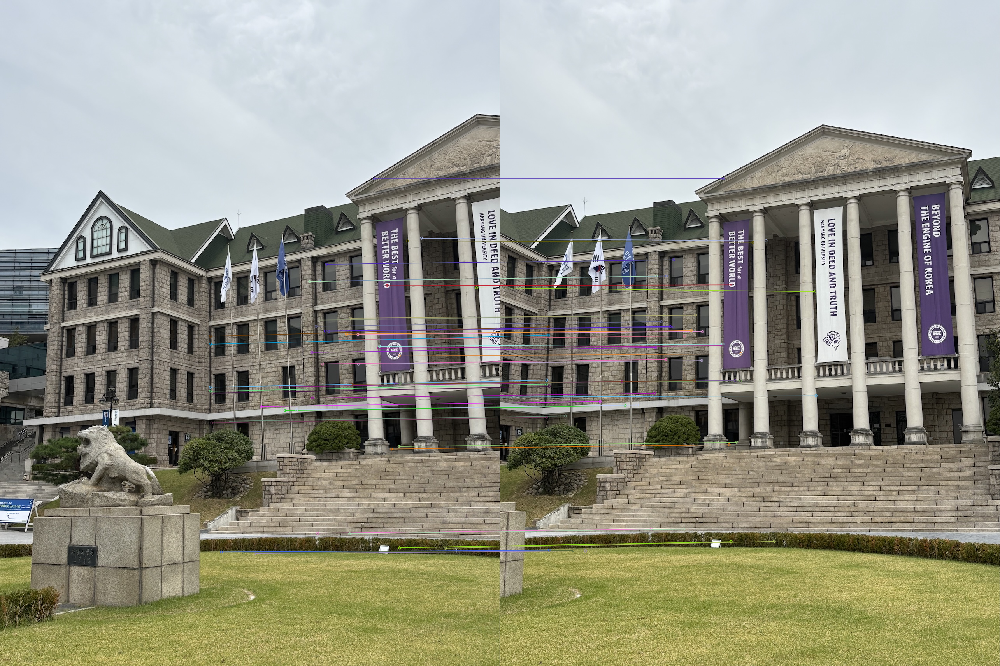

In [2]:

sorted_matches = sorted(matches1, key = lambda x : x.distance)
res = cv2.drawMatches(images[0], kps[0], images[1], kps[1], sorted_matches[:50], None, flags = 2)

from PIL import Image
Image.fromarray(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

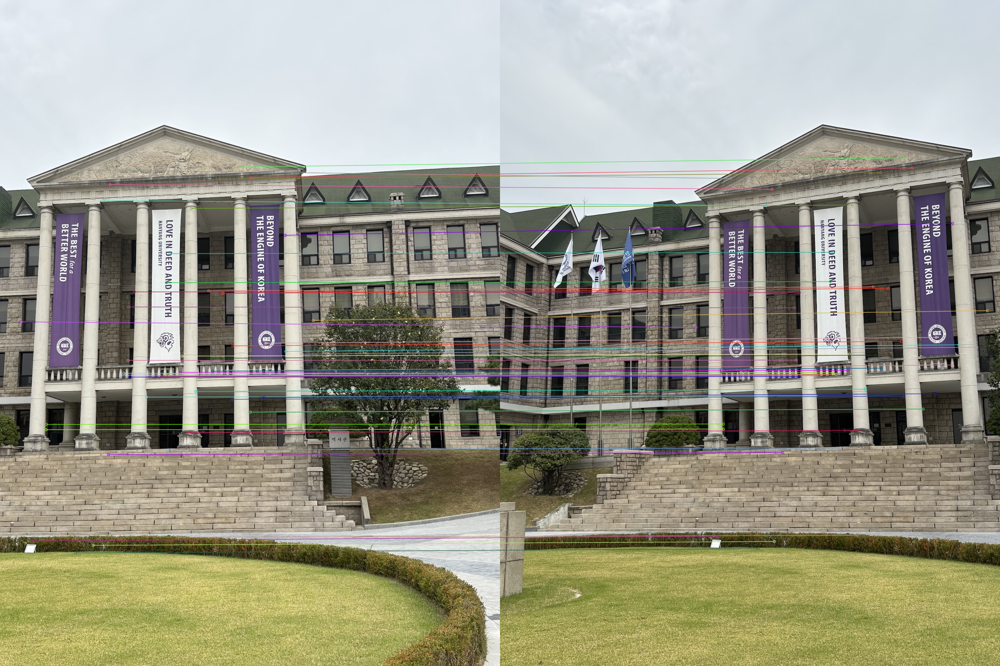

In [3]:
sorted_matches = sorted(matches2, key = lambda x : x.distance)
res = cv2.drawMatches(images[2], kps[2], images[1], kps[1], sorted_matches[:50], None, flags = 2)

from PIL import Image
Image.fromarray(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

In [5]:
height, width, _ = images[0].shape
result = np.zeros((height, width * 3, 3), dtype = np.uint8)

# Stitch image2 to image1
src = np.float32([kps[2][m.queryIdx].pt for m in matches2]).reshape((-1, 1, 2))
dst = np.float32([kps[1][m.trainIdx].pt for m in matches2]).reshape((-1, 1, 2))
H, status = cv2.findHomography(src, dst, cv2.RANSAC, 5.0)

# Prepare pixel coordinates in image1
before = []
for x in range(images[1].shape[1]):
    for y in range(images[1].shape[0]):
        point = [x, y, 1]
        before.append(point)
before = np.array(before).transpose()

# [TODO] Calculate coordinates for each pixel in image1 to image 2
after = H.dot(before)
after = after / after[2,:]
after = after[:2, :]
after = np.round(after, 0).astype(int)


for pt1, pt2 in zip(before[:2, :].transpose(), after.transpose()):
    if pt2[1] >= height:
        continue

    if np.sum(pt2 < 0) >= 1:
        continue

    result[pt2[1], width+pt2[0]] = images[2][pt1[1], pt1[0]]


# Stitch image0 to image1
src = np.float32([kps[0][m.queryIdx].pt for m in matches1]).reshape((-1, 1, 2))
dst = np.float32([kps[1][m.trainIdx].pt for m in matches1]).reshape((-1, 1, 2))
H, status = cv2.findHomography(src, dst, cv2.RANSAC, 5.0)


# Prepare pixel coordinates in image1
before = []
for x in range(images[1].shape[1]):
    for y in range(images[1].shape[0]):
        point = [x, y, 1]
        before.append(point)
before = np.array(before).transpose()

# [TODO] Calculate coordinates for each pixel in image1 to image 0
after = H.dot(before)
after = after / after[2,:]
after = after[:2, :]
after = after.astype(int)
after[0] += width

for pt1, pt2 in zip(before[:2, :].transpose(), after.transpose()):
    if pt2[1] < 0 or pt2[1] >= height:
        continue

    if any(pt2 < 0):
        continue

    result[pt2[1], pt2[0]] = images[0][pt1[1], pt1[0]]
result[0:height, width:width*2] = images[1]

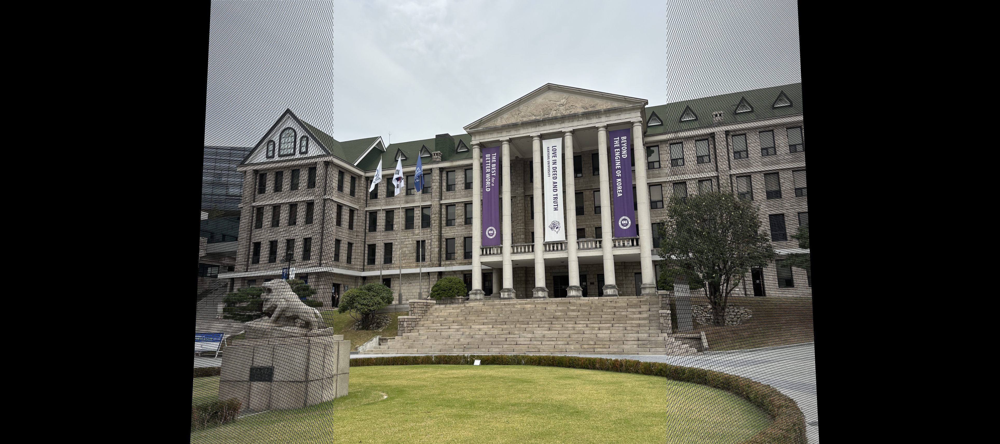

In [7]:
from PIL import Image
Image.fromarray(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))

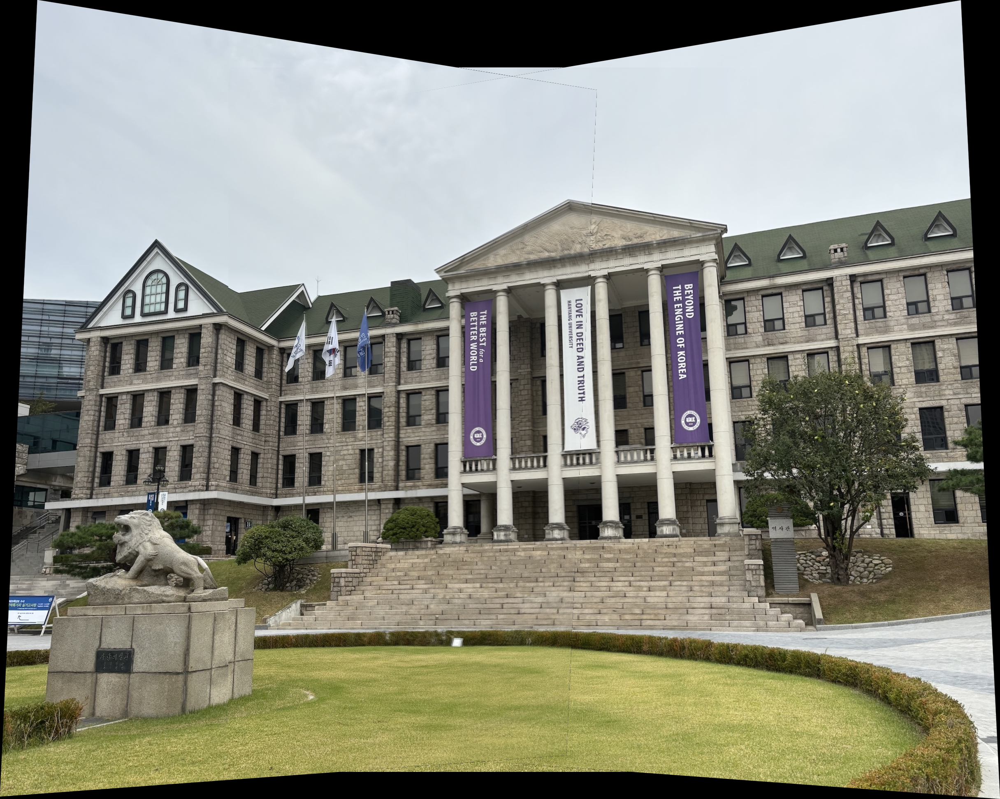

In [ ]:
# Step 1: Homography 계산
src0 = np.float32([kps[0][m.queryIdx].pt for m in matches1]).reshape((-1, 1, 2))
dst0 = np.float32([kps[1][m.trainIdx].pt for m in matches1]).reshape((-1, 1, 2))
H_0to1, _ = cv2.findHomography(src0, dst0, cv2.RANSAC, 5.0)

src2 = np.float32([kps[2][m.queryIdx].pt for m in matches2]).reshape((-1, 1, 2))
dst2 = np.float32([kps[1][m.trainIdx].pt for m in matches2]).reshape((-1, 1, 2))
H_2to1, _ = cv2.findHomography(src2, dst2, cv2.RANSAC, 5.0)

# Step 2: 파노라마 크기 계산
def corners_in_panorama(img, H):
    h, w = img.shape[:2]
    corners = np.float32([[0,0],
                          [w,0],
                          [w,h],
                          [0,h]]).reshape(-1,1,2)
    warped_corners = cv2.perspectiveTransform(corners, H)
    return warped_corners

image0, image1, image2 = images[0], images[1], images[2]

H_identity = np.eye(3)
corners_1 = corners_in_panorama(image1, H_identity)
corners_0 = corners_in_panorama(image0, H_0to1)
corners_2 = corners_in_panorama(image2, H_2to1)

all_corners = np.concatenate((corners_0, corners_1, corners_2), axis=0)
[xmin, ymin] = np.int32(all_corners.min(axis=0).ravel())
[xmax, ymax] = np.int32(all_corners.max(axis=0).ravel())

width_panorama = xmax - xmin
height_panorama = ymax - ymin

# Step 3: Warping
translation = np.array([[1, 0, -xmin],
                        [0, 1, -ymin],
                        [0, 0, 1]], dtype=np.float32)

panorama = np.zeros((height_panorama, width_panorama, 3), dtype=np.uint8)

panorama = cv2.warpPerspective(image1, translation, (width_panorama, height_panorama))

# image0, image2 warping
warped_0 = cv2.warpPerspective(image0, translation.dot(H_0to1), (width_panorama, height_panorama))
warped_2 = cv2.warpPerspective(image2, translation.dot(H_2to1), (width_panorama, height_panorama))

# 4. Feather Blending 함수
def feather_blend(base, overlay):
    # 두 이미지가 겹치는 영역 찾기
    base_mask = (base.sum(axis=2) > 0)
    overlay_mask = (overlay.sum(axis=2) > 0)
    overlap = base_mask & overlay_mask
    
    # 겹치지 않는 부분은 그대로 반영
    base[overlay_mask & (~overlap)] = overlay[overlay_mask & (~overlap)]
    
    # 겹치는 영역에 blending 적용
    # 여기서는 단순히 x좌표에 따라 가중치 변화: 
    ys, xs = np.where(overlap)
    if len(xs) > 0 and len(ys) > 0:
        x_min, x_max = xs.min(), xs.max()

        overlap_coords = (ys, xs)
        # 선형적으로 가중치 변화 (x_min 지점에서는 base비중 높고, x_max 지점에서는 overlay비중 높게)
        alpha = (xs - x_min) / (x_max - x_min + 1e-6) # 0~1 사이 값
        alpha = alpha.reshape(-1,1) # (N,1)
        
        base_pixels = base[overlap_coords].astype(np.float32)
        overlay_pixels = overlay[overlap_coords].astype(np.float32)
        
        blended = base_pixels*(1-alpha) + overlay_pixels*alpha
        blended = np.clip(blended, 0, 255).astype(np.uint8)
        
        base[overlap_coords] = blended
    
    return base

# image0와 panorama blending
panorama = feather_blend(panorama, warped_0)

# image2와 panorama blending
panorama = feather_blend(panorama, warped_2)

Image.fromarray(cv2.cvtColor(panorama, cv2.COLOR_BGR2RGB))